In [1]:
from tensorflow.keras import layers
import tensorflow as tf

import os
import numpy as np
from glob import glob
import cv2
from scipy.io import loadmat
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from collections import OrderedDict
from PIL import Image

# For data preprocessing
from tensorflow import image as tf_image
from tensorflow import data as tf_data
from tensorflow import io as tf_io

In [2]:
LABEL_TO_COLOR = OrderedDict({
"background": [255, 255, 255],
"high_vegetation": [40, 80, 0],
"traversable_grass": [128, 255, 0],
"smooth_trail": [178, 176, 153],
"obstacle": [255, 0, 0],
"sky": [1, 88, 255],
"rough_trail": [156, 76, 30],
"puddle": [255, 0, 128],
"non_traversable_low_vegetation": [0, 160, 0]
})

In [3]:
import numpy as np
from collections import OrderedDict

def create_custom_label_colormap():
    """Create a colormap from the custom LABEL_TO_COLOR mapping."""
    colormap = np.array(list(LABEL_TO_COLOR.values()))
    print(colormap)
    return colormap

def label_to_color_image(label):
    """Convert segmentation labels to color images based on custom colormap."""
    if label.ndim != 2:
        raise ValueError('Expect 2-D input label')
    
    colormap = create_custom_label_colormap()
    
    if np.max(label) >= len(colormap):
        raise ValueError('label value too large.')
    
    # return np.take(colormap, label, axis=0)
    return colormap[label]

# Example usage
label = np.array([[0, 1, 0], [2, 0, 1]])  # Example segmentation labels
color_image = label_to_color_image(label)  # Convert labels to color image


[[255 255 255]
 [ 40  80   0]
 [128 255   0]
 [178 176 153]
 [255   0   0]
 [  1  88 255]
 [156  76  30]
 [255   0 128]
 [  0 160   0]]


In [4]:
print(tf.config.list_physical_devices('GPU'))

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [5]:
IMG_HEIGHT = 544
IMG_WIDTH = 1024


IMG_SIZE = 224

NUM_EPOCHS = 20
BATCH_SIZE = 16
BUFFER_SIZE = 1000
NUM_MASK_CHANNELS = 9


LEARNING_RATE = 1e-5

DATA_DIR = "./yamaha/"

In [7]:
train_images = sorted(glob(os.path.join(DATA_DIR, "images/training/YCOR*")))
train_masks = sorted(glob(os.path.join(DATA_DIR, "annotations/training/YCOR*")))
val_images = sorted(glob(os.path.join(DATA_DIR, "images/validation/YCOR*")))
val_masks = sorted(glob(os.path.join(DATA_DIR, "annotations/validation/YCOR*")))

In [8]:
def display_example_pair(image: np.ndarray, mask: np.ndarray) -> None:
    """ Visualizes input image and segmentation map. Used for visualizations.

    Args:
        image: (np.ndarray) the rgb image
        mask: (np.ndarray) the mask of the input image

    Returns:
        None
    """
    _, ax = plt.subplots(1, 2, figsize=(15, 15))
    ax[0].imshow(image)
    ax[0].axis('off')
    ax[0].set_title('Original Image')
    ax[1].imshow(mask)
    ax[1].axis('off')
    ax[1].set_title('Mask')

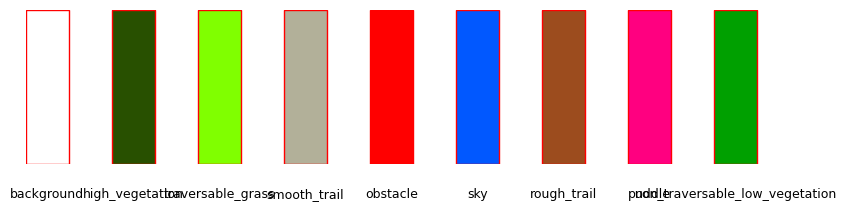

In [9]:
# Create a figure and axis for plotting
fig, ax = plt.subplots(figsize=(10, 2))

# Create mini rectangles for each color
for i, (label, color) in enumerate(LABEL_TO_COLOR.items()):
    i = i * 2
    # Normalize RGB colors
    normalized_color = [c / 255.0 for c in color]
    # Create a patch
    rect = patches.Rectangle((i, 0), 1, 1, linewidth=1, edgecolor='r', facecolor=normalized_color)
    # Add the patch to the Axes
    ax.add_patch(rect)
    # Add text label
    plt.text(i + 0.5, -0.2, label, ha='center', va='center', fontsize=9)

# Set limits and turn off axes
ax.set_xlim(0, len(LABEL_TO_COLOR) * 2)
ax.set_ylim(0, 1)
ax.axis('off')

plt.show()

In [6]:
PALETTE = list(LABEL_TO_COLOR.values())
CLASSES = list(LABEL_TO_COLOR.keys())

palette = np.array(PALETTE, dtype=np.uint8)

In [11]:
def read_image(image_path, mask=False):
    image = tf_io.read_file(image_path)
    if mask:
        image = tf_image.decode_png(image, channels=1)
        image.set_shape([None, None, 1])
        image = tf_image.resize(images=image, size=[int(IMG_SIZE), int(IMG_SIZE)])
        image = tf.cast(image, tf.int32)

        valid_values_mask = tf.logical_and(image >= 0, image <= 8)
        assert_condition = tf.debugging.assert_equal(tf.reduce_all(valid_values_mask), True, message="Mask values out of range 0 to 8")
    else:
        image = tf_image.decode_jpeg(image, channels=3)
        image.set_shape([None, None, 3])
        image = tf_image.resize(images=image, size=[int(IMG_SIZE), int(IMG_SIZE)])
    return image


def load_data(image_list, mask_list):
    image = read_image(image_list)
    mask = read_image(mask_list, mask=True)
    return image, mask


def data_generator(image_list, mask_list):
    dataset = tf_data.Dataset.from_tensor_slices((image_list, mask_list))
    dataset = dataset.map(load_data, num_parallel_calls=tf_data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder= True)
    return dataset

# IMAGE AUGMENTATION
def augment_images(image, mask):
    # Random flip
    if tf.random.uniform(()) > 0.5:
        image = tf.image.flip_left_right(image)
        mask = tf.image.flip_left_right(mask)

    # Random brightness
    image = tf.image.random_brightness(image, max_delta=0.1)

    # Random saturation
    image = tf.image.random_saturation(image, lower=0.8, upper=1.2)

    # Random Crop
    # seed = (tf.random.uniform(shape=[], dtype=tf.int32, maxval=2147483647), tf.random.uniform(shape=[], dtype=tf.int32,maxval=2147483647))
    # image = tf.image.stateless_random_crop(value = image, size = (BATCH_SIZE, IMG_SIZE, IMG_SIZE, 3), seed = seed)
    # mask = tf.image.stateless_random_crop(value = mask, size = (BATCH_SIZE, IMG_SIZE, IMG_SIZE, 1), seed = seed)   
    

    # Make sure the image is still in [0, 255]
    image = tf.clip_by_value(image, 0, 255)
    # Make sure the mask is still in [0, 8]
    mask = tf.clip_by_value(mask, 0, 8)

    return image, mask

train_dataset = data_generator(train_images, train_masks)
val_dataset = data_generator(val_images, val_masks)

train_dataset = train_dataset.map(augment_images, num_parallel_calls=tf.data.experimental.AUTOTUNE)
val_dataset = val_dataset.map(augment_images, num_parallel_calls=tf.data.experimental.AUTOTUNE)

print("Train Dataset:", train_dataset)
print("Val Dataset:", val_dataset)

Train Dataset: <ParallelMapDataset element_spec=(TensorSpec(shape=(16, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(16, 224, 224, 1), dtype=tf.int32, name=None))>
Val Dataset: <ParallelMapDataset element_spec=(TensorSpec(shape=(16, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(16, 224, 224, 1), dtype=tf.int32, name=None))>


In [7]:
def convolution_block(
    block_input,
    num_filters=128,
    kernel_size=3,
    dilation_rate=1,
    use_bias=False,
):
    x = layers.Conv2D(
        num_filters,
        kernel_size=kernel_size,
        dilation_rate=dilation_rate,
        padding="same",
        use_bias=use_bias,
        kernel_initializer=tf.keras.initializers.HeNormal(),
    )(block_input)
    x = layers.BatchNormalization()(x)
    return tf.nn.relu(x)


def DilatedSpatialPyramidPooling(dspp_input):
    dims = dspp_input.shape
    x = layers.AveragePooling2D(pool_size=(dims[-3], dims[-2]))(dspp_input)
    x = convolution_block(x, kernel_size=1, use_bias=True)
    out_pool = layers.UpSampling2D(
        size=(dims[-3] // x.shape[1], dims[-2] // x.shape[2]),
        interpolation="bilinear",
    )(x)

    print(dims)

    out_1 = convolution_block(dspp_input, kernel_size=1, dilation_rate=1)
    out_6 = convolution_block(dspp_input, kernel_size=3, dilation_rate=3)
    # out_12 = convolution_block(dspp_input, kernel_size=3, dilation_rate=12)
    # out_18 = convolution_block(dspp_input, kernel_size=3, dilation_rate=18)

    # x = layers.Concatenate(axis=-1)([out_pool, out_1, out_6, out_12, out_18])
    x = layers.Concatenate(axis=-1)([out_pool, out_1, out_6])
    output = convolution_block(x, kernel_size=1)
    return output

In [8]:
model_input = tf.keras.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
model_input = tf.keras.layers.Resizing(IMG_SIZE, IMG_SIZE)(model_input)
preprocessed = tf.keras.applications.mobilenet_v2.preprocess_input(model_input)

In [9]:
mobileNetv2 = tf.keras.applications.MobileNetV2(weights="imagenet", alpha=0.75, include_top=False, input_tensor=preprocessed)
mobileNetv2.summary()

Model: "mobilenetv2_0.75_224"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 resizing (Resizing)            (None, 224, 224, 3)  0           ['input_1[0][0]']                
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['resizing[0][0]']               
                                                                                                  
 tf.math.subtract (TFOpLambda)  (None, 224, 224, 3)  0           ['tf.math.true

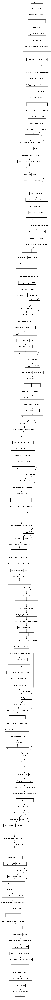

In [10]:
tf.keras.utils.plot_model(mobileNetv2)

In [11]:
def DeeplabV3Plus(image_size, num_classes):
    x = mobileNetv2.get_layer("block_16_project_BN").output
    # x = mobileNetv2.get_layer("block_12_add").output
    x = DilatedSpatialPyramidPooling(x)

    input_a = layers.UpSampling2D(
        size=(image_size // 4 // x.shape[1], image_size // 4 // x.shape[2]),
        interpolation="bilinear",
    )(x)
    print(input_a)

    # There are many o
    input_b = mobileNetv2.get_layer("block_2_depthwise_BN").output
    # input_b = mobileNetv2.get_layer("block_2_add").output
    print(input_b)
    input_b = convolution_block(input_b, num_filters=48, kernel_size=1)
    print(input_b)

    x = layers.Concatenate(axis=-1)([input_a, input_b])
    x = convolution_block(x)
    x = convolution_block(x)
    x = layers.UpSampling2D(
        size=(image_size // x.shape[1], image_size // x.shape[2]),
        interpolation="bilinear",
    )(x)
    model_output = layers.Conv2D(num_classes, kernel_size=(1, 1), padding="same")(x)
    # model_output = layers.Reshape((-1, 1))(model_output)
    return tf.keras.Model(inputs=model_input, outputs=model_output)


model = DeeplabV3Plus(image_size=IMG_SIZE, num_classes=9)
model.summary()

(None, 7, 7, 240)
KerasTensor(type_spec=TensorSpec(shape=(None, 56, 56, 128), dtype=tf.float32, name=None), name='up_sampling2d_1/resize/ResizeBilinear:0', description="created by layer 'up_sampling2d_1'")
KerasTensor(type_spec=TensorSpec(shape=(None, 56, 56, 144), dtype=tf.float32, name=None), name='block_2_depthwise_BN/FusedBatchNormV3:0', description="created by layer 'block_2_depthwise_BN'")
KerasTensor(type_spec=TensorSpec(shape=(None, 56, 56, 48), dtype=tf.float32, name=None), name='tf.nn.relu_4/Relu:0', description="created by layer 'tf.nn.relu_4'")
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                          

In [21]:
save_root = "./MobileNetV2_Deeplabv3_Checkpoint"

checkpoint_dir = os.path.join(save_root, "callbacks_checkpoints")
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt_{epoch}")

print(checkpoint_dir)
print(checkpoint_prefix)

./MobileNetV2_Deeplabv3_Checkpoint\callbacks_checkpoints
./MobileNetV2_Deeplabv3_Checkpoint\callbacks_checkpoints\ckpt_{epoch}


In [22]:
epochs = 70

# Learning Rate Scheduler
def decay(epoch):
    ####### 실습 #######
    if epoch < 3:
        return 1e-3
    elif epoch >= 3 and epoch < 7:
        return 1e-4
    else:
        return 1e-5
    ###################
    
import math
def exp_decay(epoch):
    ####### 실습 #######
    return 0.0003 * math.exp(0.1 * (2 - epoch))

In [23]:
# Custom Callback : Print Learning rate every epoch
class PrintLR(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        print("\n Epoch {}'s Learning rate is {} \n".format(epoch + 1 , model.optimizer.lr.numpy()))

In [24]:
callbacks = [
    tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_prefix, save_weights_only = True),
    tf.keras.callbacks.LearningRateScheduler(exp_decay),
    tf.keras.callbacks.EarlyStopping(monitor="accuracy", patience=10),
    PrintLR()
]

In [25]:
# SPARSECATEGORICAL LOSS + IOU LOSS
def softIoULoss(true, pred, smooth=1e-6):
    SCE = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True, ignore_class=0)
    
    sce = SCE(true, pred)
    
    # pred = tf.squeeze(pred)
    # pred = tf.math.argmax(pred, axis=3)  # argmax not differentiable!!!!!!!
    pred = tf.nn.softmax(pred, axis=-1)

    # Flatten the tensors
    true = tf.reshape(true, [-1])
    pred = tf.reshape(pred, [-1, tf.shape(pred)[-1]])

    # Convert ground truth to one hot format
    true_one_hot = tf.one_hot(tf.cast(true, tf.int32), depth=tf.shape(pred)[-1])

    pred = tf.cast(pred, dtype=tf.float32)
    true = tf.cast(true_one_hot, dtype=tf.float32)
    
    intersection = tf.math.reduce_sum( tf.keras.layers.Dot(axes=(1,1))([pred, true]) )   
    total = tf.math.reduce_sum(pred) + tf.math.reduce_sum(true)
    union = total - intersection

    IoU = (intersection + smooth) / (union + smooth)
    return 1 - IoU + sce


Epoch 1/70
58/58 [==============================] - ETA: 0s - loss: 2.0587 - accuracy: 0.5441
 Epoch 1's Learning rate is 0.00036642083432525396 

58/58 [==============================] - 16s 131ms/step - loss: 2.0587 - accuracy: 0.5441 - val_loss: 5.0004 - val_accuracy: 0.2975 - lr: 3.6642e-04
Epoch 2/70
58/58 [==============================] - ETA: 0s - loss: 1.5107 - accuracy: 0.6543
 Epoch 2's Learning rate is 0.0003315512731205672 

58/58 [==============================] - 7s 114ms/step - loss: 1.5107 - accuracy: 0.6543 - val_loss: 2.2202 - val_accuracy: 0.5913 - lr: 3.3155e-04
Epoch 3/70
58/58 [==============================] - ETA: 0s - loss: 1.3106 - accuracy: 0.7058
 Epoch 3's Learning rate is 0.0003000000142492354 

58/58 [==============================] - 7s 114ms/step - loss: 1.3106 - accuracy: 0.7058 - val_loss: 2.1862 - val_accuracy: 0.5430 - lr: 3.0000e-04
Epoch 4/70
58/58 [==============================] - ETA: 0s - loss: 1.1879 - accuracy: 0.7414
 Epoch 4's Learning ra

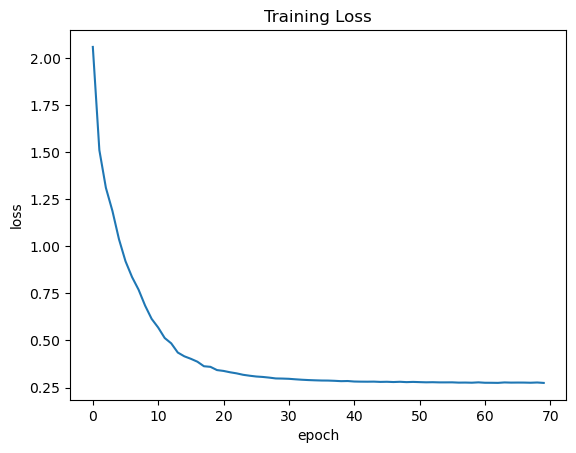

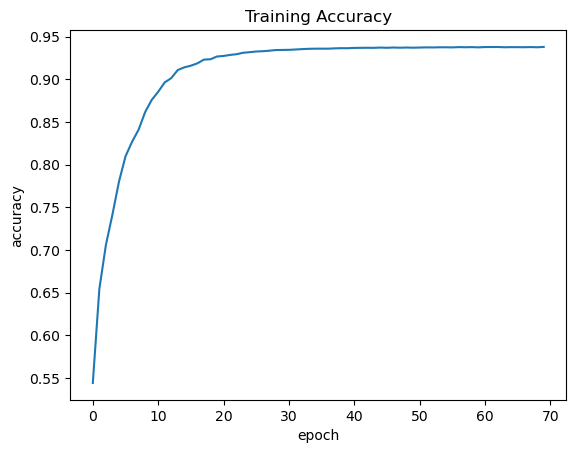

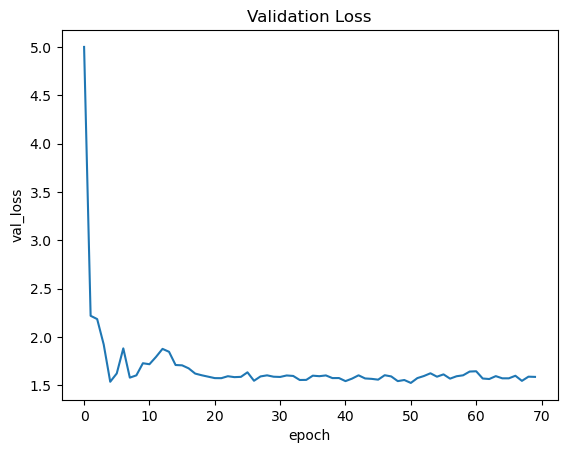

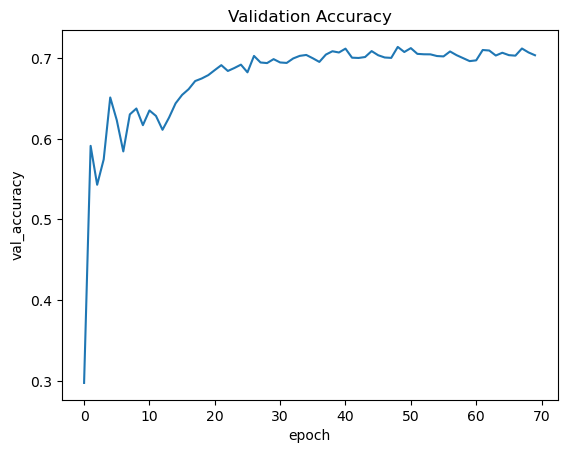

In [26]:
model.compile(
    optimizer=tf.keras.optimizers.Adam(),
    loss=softIoULoss,
    metrics=["accuracy"],
)

history = model.fit(train_dataset, validation_data=val_dataset, epochs=epochs, callbacks=callbacks)

plt.plot(history.history["loss"])
plt.title("Training Loss")
plt.ylabel("loss")
plt.xlabel("epoch")
plt.show()

plt.plot(history.history["accuracy"])
plt.title("Training Accuracy")
plt.ylabel("accuracy")
plt.xlabel("epoch")
plt.show()

plt.plot(history.history["val_loss"])
plt.title("Validation Loss")
plt.ylabel("val_loss")
plt.xlabel("epoch")
plt.show()

plt.plot(history.history["val_accuracy"])
plt.title("Validation Accuracy")
plt.ylabel("val_accuracy")
plt.xlabel("epoch")
plt.show()

In [13]:
save_root = "./MobileNetV2_Deeplabv3_Checkpoint"

checkpoint_dir = os.path.join(save_root, "callbacks_checkpoints")
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt_{epoch}")

print(checkpoint_dir)
print(checkpoint_prefix)

latest = tf.train.latest_checkpoint(checkpoint_dir)
latest

./MobileNetV2_Deeplabv3_Checkpoint\callbacks_checkpoints
./MobileNetV2_Deeplabv3_Checkpoint\callbacks_checkpoints\ckpt_{epoch}


'./MobileNetV2_Deeplabv3_Checkpoint\\callbacks_checkpoints\\ckpt_70'

In [14]:
model.load_weights(latest)
model

In [38]:
def infer(model, image_tensor):
    # print(image_tensor)
    predictions = model.predict(np.expand_dims((image_tensor), axis = 0))
    print(type(predictions))
    predictions = np.squeeze(predictions)
    print(predictions.shape)
    predictions = np.argmax(predictions, axis=-1)
    print(predictions.shape)
    return predictions

def decode_segmentation_masks(mask, colormap, n_classes):
    r = np.zeros_like(mask).astype(np.uint8)
    g = np.zeros_like(mask).astype(np.uint8)
    b = np.zeros_like(mask).astype(np.uint8)
    for l in range(0, n_classes):
        idx = mask == l
        r[idx] = colormap[l, 0]
        g[idx] = colormap[l, 1]
        b[idx] = colormap[l, 2]
    rgb = np.stack([r, g, b], axis=2)
    return rgb


def get_overlay(image, colored_mask):
    image = tf.keras.utils.array_to_img(image)
    image = np.array(image).astype(np.uint8)
    overlay = cv2.addWeighted(image, 0.35, colored_mask, 0.65, 0)
    return overlay

def get_overlay_lines(image, line_height_ratio, line_offset_ratio, offset):
    image = tf.keras.utils.array_to_img(image)
    image = np.array(image).astype(np.uint8)
    height, width, _ = image.shape

    lines = np.zeros((height, width, 3))
    
    center_line_x = width // 2
    left_line_x = center_line_x - int(width * line_offset_ratio)
    right_line_x = center_line_x + int(width * line_offset_ratio)

    line_height_ratio = 1 - line_height_ratio

    # line_endpoints (start_x, start_y, end_x, end_y)
    line_endpoints = [(center_line_x - offset, int(height * line_height_ratio), center_line_x - offset, height),
                      (center_line_x + offset, int(height * line_height_ratio), center_line_x + offset, height),
                      (left_line_x - offset, int(height * line_height_ratio), left_line_x - offset, height),
                      (left_line_x + offset, int(height * line_height_ratio), left_line_x + offset, height),
                      (right_line_x - offset, int(height * line_height_ratio), right_line_x - offset, height),
                      (right_line_x + offset, int(height * line_height_ratio), right_line_x + offset, height)
                     ]

    color_lines = [(255,0,0),
                   (255,0,0),
                   (0,255,0),
                   (0,255,0),
                   (0, 0,255),
                  (0, 0,255)]

    for i in range(6):
        cv2.line(lines, line_endpoints[i][:2], line_endpoints[i][2:], color_lines[i], 2)

    lines = lines.astype(np.uint8)

    overlay = cv2.addWeighted(image, 0.35, lines, 0.65, 0)
    return overlay

# inferred_image is numpy
# traversable_labels : "traversable_grass" , "smooth_trail", "rough_trail" rough_trail 추가할까요..? -> index : 2,3,6 
# 흠... puddle 은?

TRAVERSABLE_LABELS = [2, 3]

def calculate_direction(inferred_image, line_height_ratio, line_offset_ratio, offset, traversable_labels):
    height, width = inferred_image.shape # (224, 224) 

    center_line_x = width // 2
    left_line_x = center_line_x - int(width * line_offset_ratio)
    right_line_x = center_line_x + int(width * line_offset_ratio)

    # [row, column]
    line_height_ratio = 1 - line_height_ratio
    height_norm = int(height * line_height_ratio)
    
    center_overlap = 0
    for i in range(center_line_x - offset, center_line_x + offset + 1):
        center_overlap += np.isin(inferred_image[height_norm:, i], traversable_labels).sum()
    center_overlap /= (2 * offset)

    right_overlap = 0
    for i in range(right_line_x - offset, right_line_x + offset + 1):
        right_overlap += np.isin(inferred_image[height_norm:, i], traversable_labels).sum()
    right_overlap /= (2 * offset)
    
    left_overlap = 0
    for i in range(left_line_x - offset, left_line_x + offset + 1):
        left_overlap += np.isin(inferred_image[height_norm:, i], traversable_labels).sum()
    left_overlap /= (2 * offset)

    # Determine direction based on overlaps
    direction = "Hard to tell"
    if center_overlap > 0.2 * height:
        if center_overlap > 0.4 * height:
            direction = "Straight"
        else:
            if left_overlap > right_overlap + 0.1 * height:  # Check if it's discernable
                direction = "Turn left"
            elif right_overlap > left_overlap + 0.1 * height:
                direction = "Turn right"
    else:
        direction = "Stop"

    print(f"left overlap : {left_overlap}")
    print(f"center overlap : {center_overlap}")
    print(f"right overlap : {right_overlap}")
    print(direction)
    
    


def plot_samples_matplotlib(display_list, figsize=(5, 3)):
    _, axes = plt.subplots(nrows=1, ncols=len(display_list), figsize=figsize)
    for i in range(len(display_list)):
        if display_list[i].shape[-1] == 3:
            print(f"{display_list[i].shape} : {i}")
            axes[i].imshow(tf.keras.utils.array_to_img(display_list[i]))
        else:
            print(f"{display_list[i].shape} : {i}")
            axes[i].imshow(display_list[i])
    plt.show()
    


def plot_predictions(images_list, colormap, model):
    for image_file in images_list:
        print(image_file)
        # Option 1 : read_image / Option 2 : read_image_crop
        image_tensor = read_image(image_file)
        prediction_mask = infer(image_tensor=image_tensor, model=model)
        # print(prediction_mask.shape) (224, 224)
        prediction_colormap = decode_segmentation_masks(prediction_mask, colormap, 9)
        overlay = get_overlay(image_tensor, prediction_colormap)
        # print(image_tensor) # tensor
        overlay_lines = get_overlay_lines(image_tensor, 0.5, 0.2, 15)
        plot_samples_matplotlib(
            [image_tensor, overlay, overlay_lines, prediction_colormap], figsize=(18, 14)
        )
        calculate_direction(prediction_mask, 0.5, 0.2, 15, TRAVERSABLE_LABELS)

def read_image(image_path, mask=False):
    image = tf_io.read_file(image_path)
    if mask:
        image = tf_image.decode_png(image, channels=1)
        image.set_shape([None, None, 1])
        image = tf_image.resize(images=image, size=[IMG_SIZE, IMG_SIZE])
        image = tf.cast(image, tf.int32)

        valid_values_mask = tf.logical_and(image >= 0, image <= 8)
        assert_condition = tf.debugging.assert_equal(tf.reduce_all(valid_values_mask), True, message="Mask values out of range 0 to 8")
    else:
        image = tf_image.decode_jpeg(image, channels=3)
        image.set_shape([None, None, 3])
        image = tf_image.resize(images=image, size=[IMG_SIZE, IMG_SIZE])
    return image

# Not resizing, but cropping the image
def read_image_crop(image_path):
    image = tf.io.read_file(image_path)
    image = tf_image.decode_jpeg(image, channels=3)

    print(tf.shape(image).numpy())
    # Assuming you have the original dimensions as orig_height and orig_width
    orig_height, orig_width, _ = tf.shape(image).numpy()# you need to obtain these values dynamically
    
    # Calculate start points for cropping
    start_x = (orig_width - 224) // 2
    start_y = orig_height - 224
    
    # Crop the image
    image = tf.image.crop_to_bounding_box(image, start_y, start_x, 224, 224)
    
    return image


In [16]:
image_path = glob("./example*")
# Image.open(image_path)
print(image_path)

['.\\example01.jpg', '.\\example02.jpg', '.\\example03.jpg', '.\\example04.jpg', '.\\example05.jpg', '.\\example06.jpg', '.\\example07.jpg', '.\\example08.jpg', '.\\example09.jpg', '.\\example10.jpg', '.\\example11.jpg', '.\\example_Gwanak.jpg', '.\\example_Gwanak2.jpg', '.\\example_Gwanak3.jpg', '.\\example_Gwanak4.jpg']


.\example01.jpg
1/1 [==============================] - 0s 21ms/step
<class 'numpy.ndarray'>
(224, 224, 9)
(224, 224)
(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2
(224, 224, 3) : 3


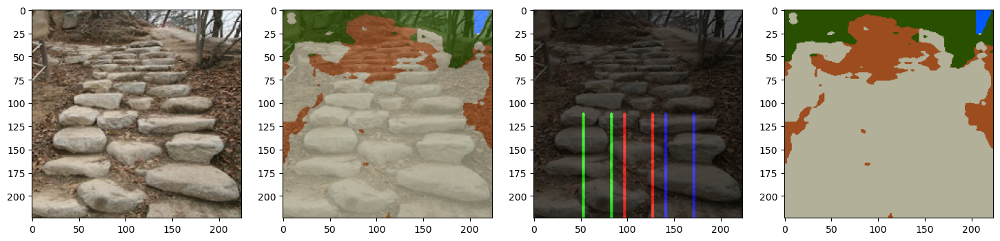

left overlap : 115.5
center overlap : 115.16666666666667
right overlap : 115.73333333333333
Straight
.\example02.jpg
1/1 [==============================] - 0s 19ms/step
<class 'numpy.ndarray'>
(224, 224, 9)
(224, 224)
(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2
(224, 224, 3) : 3


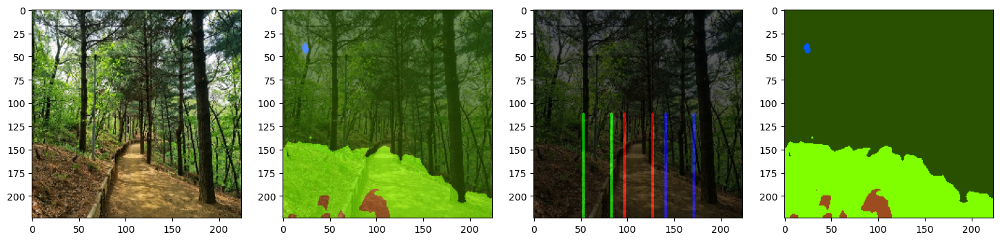

left overlap : 74.53333333333333
center overlap : 61.733333333333334
right overlap : 53.333333333333336
Hard to tell
.\example03.jpg
1/1 [==============================] - 0s 19ms/step
<class 'numpy.ndarray'>
(224, 224, 9)
(224, 224)
(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2
(224, 224, 3) : 3


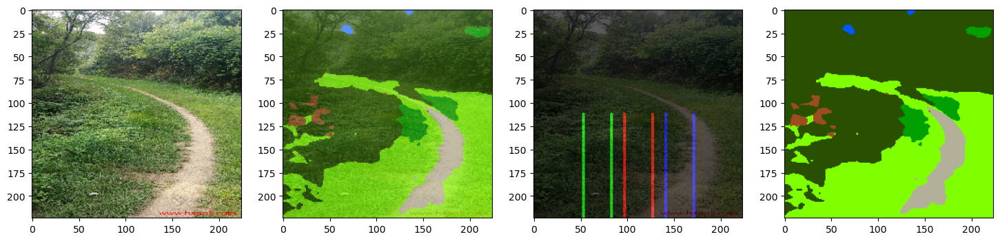

left overlap : 60.766666666666666
center overlap : 77.06666666666666
right overlap : 104.33333333333333
Turn right
.\example04.jpg
1/1 [==============================] - 0s 21ms/step
<class 'numpy.ndarray'>
(224, 224, 9)
(224, 224)
(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2
(224, 224, 3) : 3


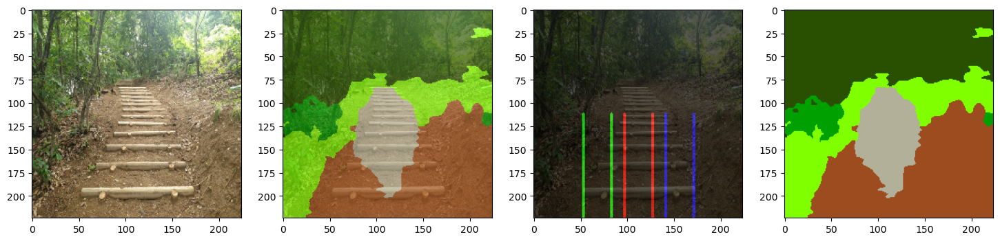

left overlap : 35.53333333333333
center overlap : 84.43333333333334
right overlap : 11.4
Turn left
.\example05.jpg
1/1 [==============================] - 0s 21ms/step
<class 'numpy.ndarray'>
(224, 224, 9)
(224, 224)
(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2
(224, 224, 3) : 3


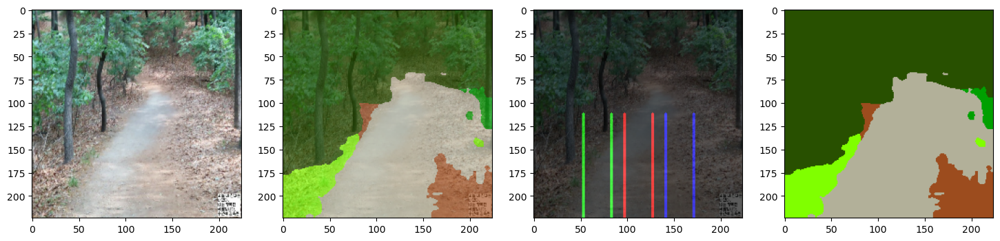

left overlap : 80.73333333333333
center overlap : 115.73333333333333
right overlap : 93.1
Straight
.\example06.jpg
1/1 [==============================] - 0s 19ms/step
<class 'numpy.ndarray'>
(224, 224, 9)
(224, 224)
(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2
(224, 224, 3) : 3


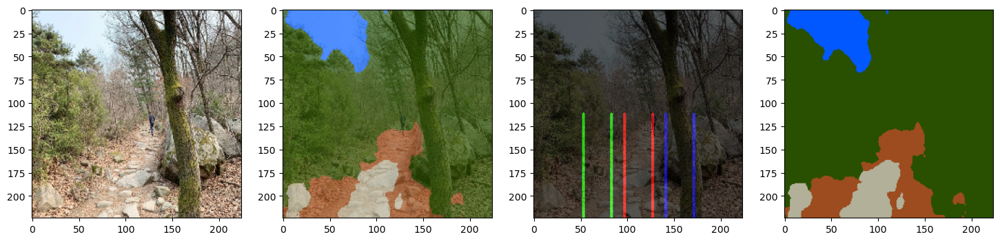

left overlap : 18.8
center overlap : 44.5
right overlap : 0.0
Stop
.\example07.jpg
1/1 [==============================] - 0s 21ms/step
<class 'numpy.ndarray'>
(224, 224, 9)
(224, 224)
(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2
(224, 224, 3) : 3


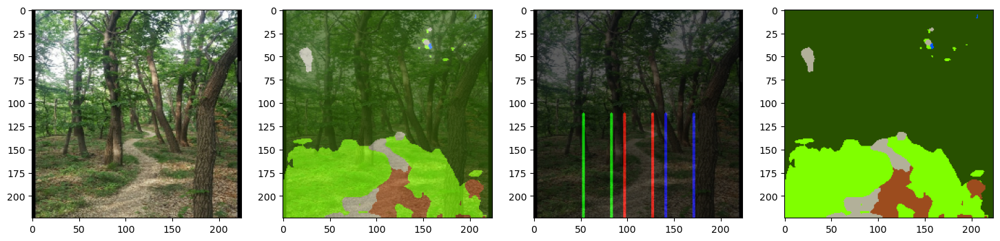

left overlap : 81.93333333333334
center overlap : 51.733333333333334
right overlap : 63.56666666666667
Hard to tell
.\example08.jpg
1/1 [==============================] - 0s 20ms/step
<class 'numpy.ndarray'>
(224, 224, 9)
(224, 224)
(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2
(224, 224, 3) : 3


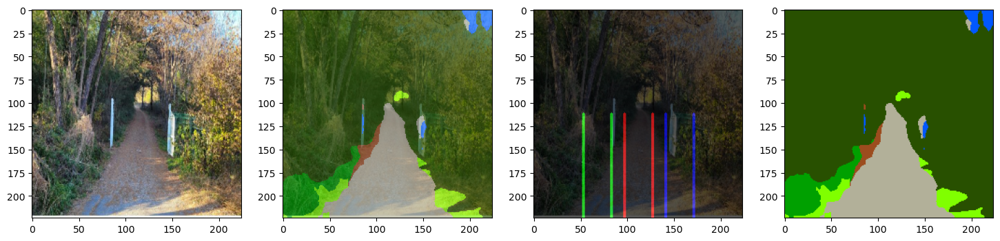

left overlap : 43.2
center overlap : 106.2
right overlap : 52.833333333333336
Straight
.\example09.jpg
1/1 [==============================] - 0s 20ms/step
<class 'numpy.ndarray'>
(224, 224, 9)
(224, 224)
(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2
(224, 224, 3) : 3


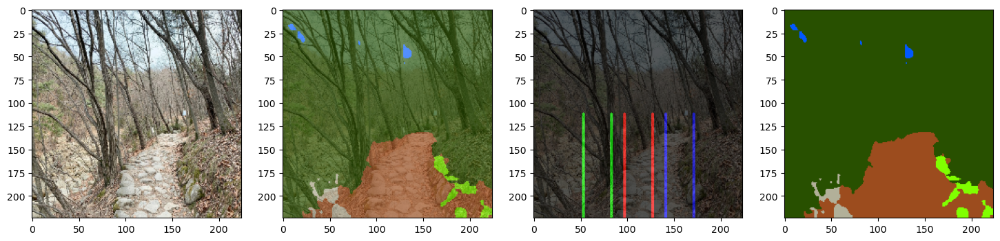

left overlap : 11.1
center overlap : 0.0
right overlap : 5.633333333333334
Stop
.\example10.jpg
1/1 [==============================] - 0s 21ms/step
<class 'numpy.ndarray'>
(224, 224, 9)
(224, 224)
(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2
(224, 224, 3) : 3


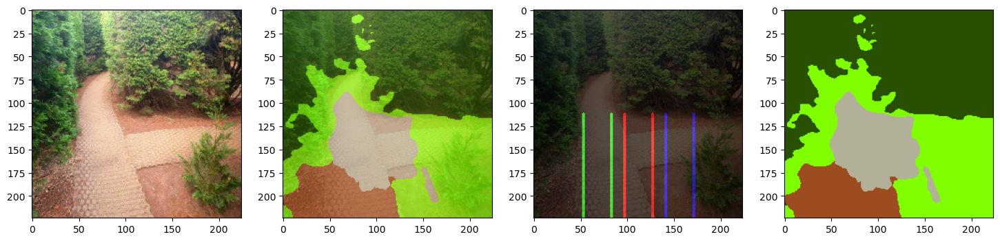

left overlap : 66.53333333333333
center overlap : 87.9
right overlap : 114.1
Turn right
.\example11.jpg
1/1 [==============================] - 0s 19ms/step
<class 'numpy.ndarray'>
(224, 224, 9)
(224, 224)
(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2
(224, 224, 3) : 3


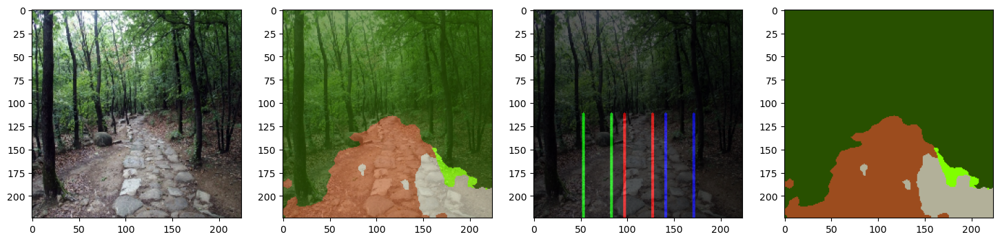

left overlap : 0.6
center overlap : 0.1
right overlap : 57.7
Stop
.\example_Gwanak.jpg
1/1 [==============================] - 0s 19ms/step
<class 'numpy.ndarray'>
(224, 224, 9)
(224, 224)
(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2
(224, 224, 3) : 3


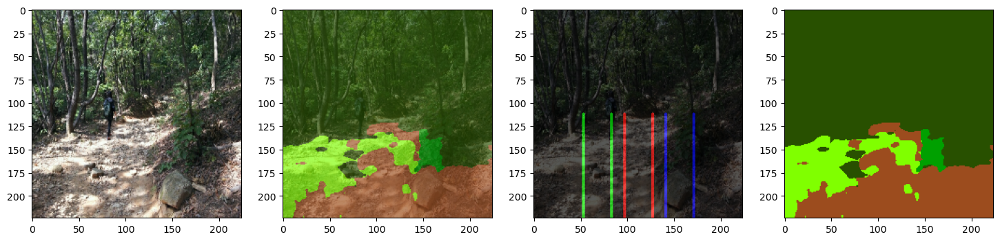

left overlap : 31.533333333333335
center overlap : 20.466666666666665
right overlap : 2.3
Stop
.\example_Gwanak2.jpg
1/1 [==============================] - 0s 24ms/step
<class 'numpy.ndarray'>
(224, 224, 9)
(224, 224)
(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2
(224, 224, 3) : 3


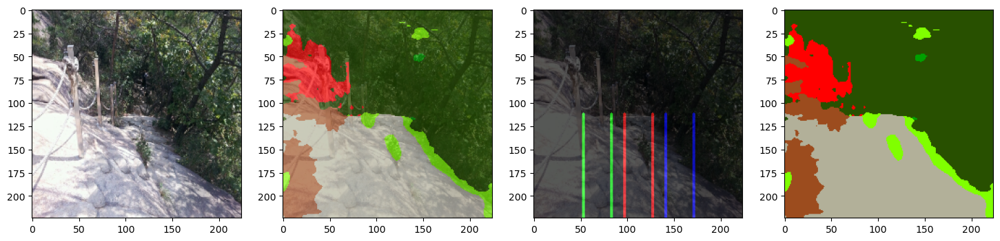

left overlap : 106.93333333333334
center overlap : 114.13333333333334
right overlap : 82.83333333333333
Straight
.\example_Gwanak3.jpg
1/1 [==============================] - 0s 20ms/step
<class 'numpy.ndarray'>
(224, 224, 9)
(224, 224)
(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2
(224, 224, 3) : 3


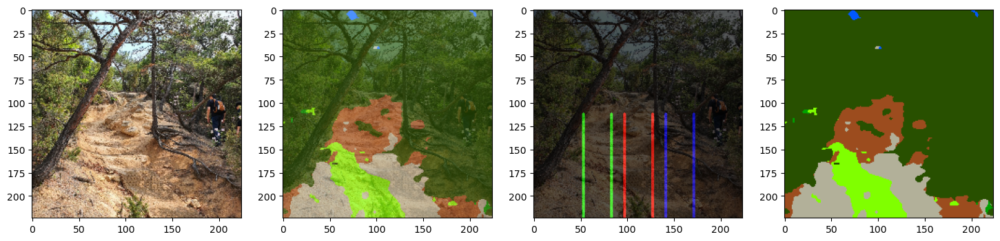

left overlap : 73.86666666666666
center overlap : 73.66666666666667
right overlap : 28.133333333333333
Turn left
.\example_Gwanak4.jpg
1/1 [==============================] - 0s 21ms/step
<class 'numpy.ndarray'>
(224, 224, 9)
(224, 224)
(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2
(224, 224, 3) : 3


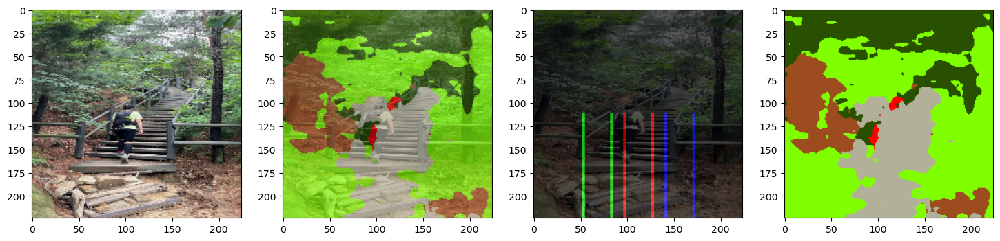

left overlap : 81.66666666666667
center overlap : 112.9
right overlap : 108.36666666666666
Straight


In [39]:
plot_predictions(image_path, palette, model=model)

In [30]:
def representative_data_gen():
    for input_value in val_dataset.batch(1).take(100):
        yield [input_value[0][0]]

In [31]:
# TFLITE
converter = tf.lite.TFLiteConverter.from_keras_model(model)
converter.optimizations = [tf.lite.Optimize.DEFAULT]
converter.representative_dataset = representative_data_gen

# Ensure that if any ops can't be optimized, the converter throws an error
converter.target_spec.supported_ops = [tf.lite.OpsSet.TFLITE_BUILTINS_INT8]

# Set the input and output tensors to uint8 
converter.inference_input_type = tf.uint8
converter.inference_output_type = tf.uint8

post_quant_tflite_model = converter.convert()



INFO:tensorflow:Assets written to: C:\Users\TFG557~1\AppData\Local\Temp\tmp6b74mj3c\assets


INFO:tensorflow:Assets written to: C:\Users\TFG557~1\AppData\Local\Temp\tmp6b74mj3c\assets
C:\Users\TFG5576XG\miniconda3\envs\tf\lib\site-packages\tensorflow\lite\python\convert.py:766: UserWarning: Statistics for quantized inputs were expected, but not specified; continuing anyway.
  warnings.warn("Statistics for quantized inputs were expected, but not "


In [32]:
# interpreter
post_quant_interpreter = tf.lite.Interpreter(model_content=post_quant_tflite_model)

In [33]:
print(post_quant_interpreter.get_input_details())
print(post_quant_interpreter.get_output_details())

[{'name': 'serving_default_args_0:0', 'index': 0, 'shape': array([  1, 224, 224,   3]), 'shape_signature': array([ -1, 224, 224,   3]), 'dtype': <class 'numpy.uint8'>, 'quantization': (1.0, 0), 'quantization_parameters': {'scales': array([1.], dtype=float32), 'zero_points': array([0]), 'quantized_dimension': 0}, 'sparsity_parameters': {}}]
[{'name': 'StatefulPartitionedCall:0', 'index': 217, 'shape': array([  1, 224, 224,   9]), 'shape_signature': array([ -1, 224, 224,   9]), 'dtype': <class 'numpy.uint8'>, 'quantization': (0.09258336573839188, 104), 'quantization_parameters': {'scales': array([0.09258337], dtype=float32), 'zero_points': array([104]), 'quantized_dimension': 0}, 'sparsity_parameters': {}}]


In [34]:
def inference_on_tflite(data_paths, evaluator):        
    input_details = evaluator.get_input_details()[0]
    output_details = evaluator.get_output_details()[0]

    data_path_len = len(data_paths)
    output = [None] * data_path_len
    
    for index, data_path in enumerate(data_paths):
        input_data = Image.open(data_path)
        input_data = input_data.resize((input_details["shape"][1], input_details["shape"][2]))
        input_data = np.array(input_data)

        evaluator.allocate_tensors()

        if input_details["dtype"] == np.uint8:
            input_scale, input_zero_point = input_details["quantization"]
            input_data = input_data / input_scale + input_zero_point

        input_data = np.expand_dims(input_data, axis=0).astype(input_details["dtype"])

        evaluator.set_tensor(input_details["index"], input_data)
    
        evaluator.invoke()
    
        output[index] = evaluator.get_tensor(output_details["index"])
    # output_scale, output_zero_point = output_details["quantization"]
    # return output / output_scale + output_zero_point
    return output

In [35]:
out = inference_on_tflite(image_path, post_quant_interpreter)

In [36]:
def quant_plot_predictions(image_lists, outputs, colormap):
    for index, out in enumerate(outputs):
        out_min = out.min()
        out_max = out.max()
        
        scaled_data = (out - out_min) / (out_max - out_min) * 8
        scaled_data = scaled_data.astype(np.uint8)

        scaled_data = np.squeeze(scaled_data)
        scaled_data = np.argmax(scaled_data, axis=2)
        scaled_data_colormap = decode_segmentation_masks(scaled_data, palette, 9)

        image_tensor = read_image(image_lists[index])

        overlay = get_overlay(image_tensor, scaled_data_colormap)

        plot_samples_matplotlib(
            [image_tensor, overlay, scaled_data_colormap], figsize=(18, 14)
        )

(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2


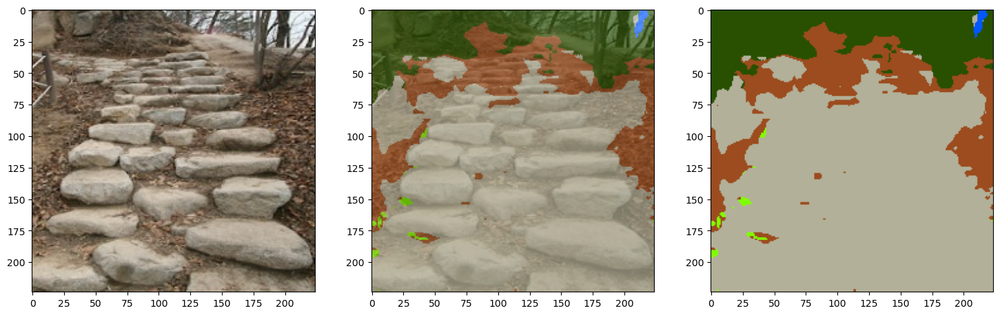

(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2


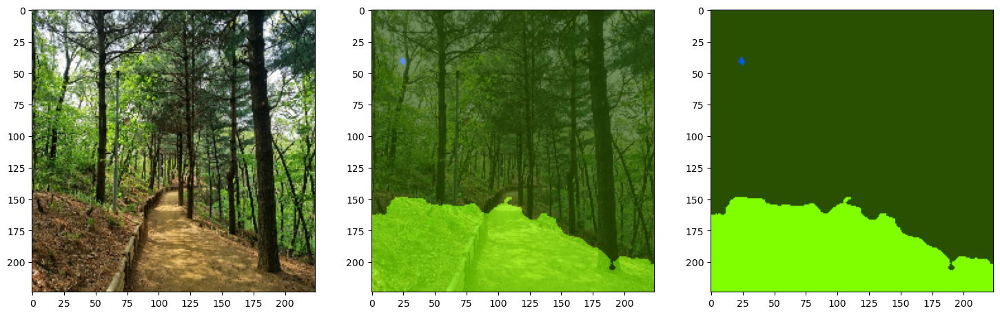

(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2


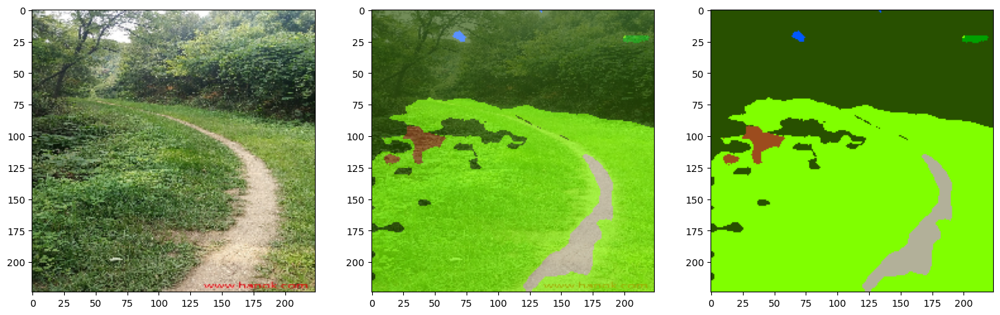

(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2


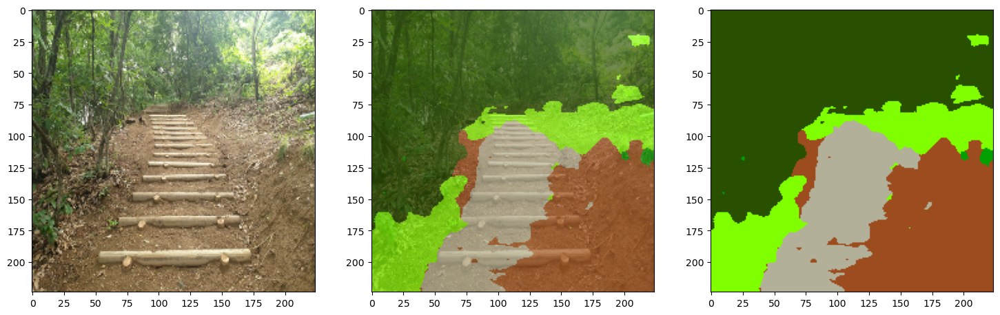

(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2


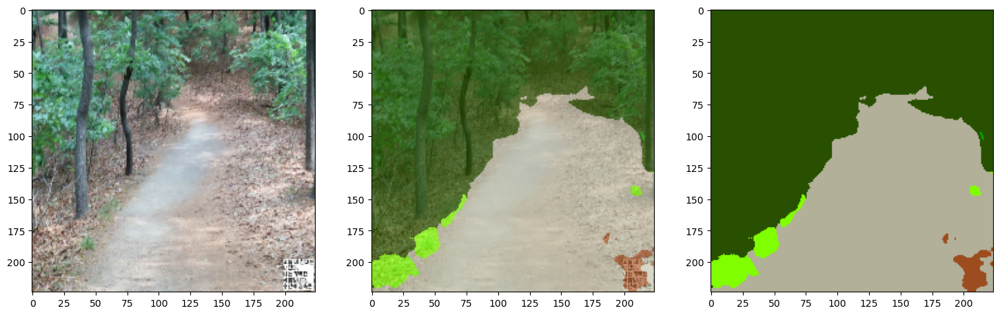

(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2


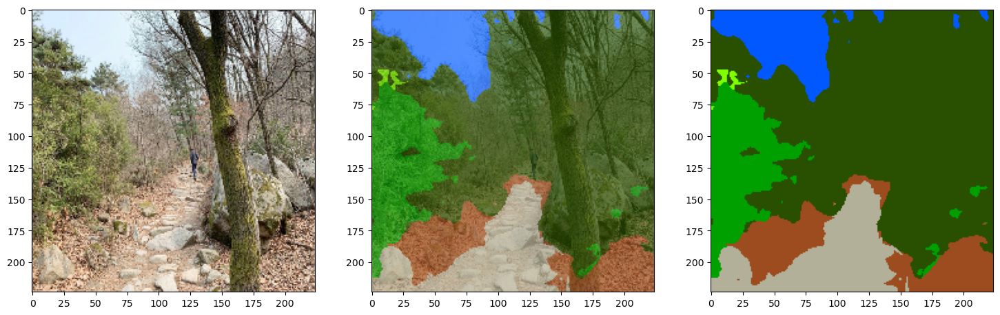

(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2


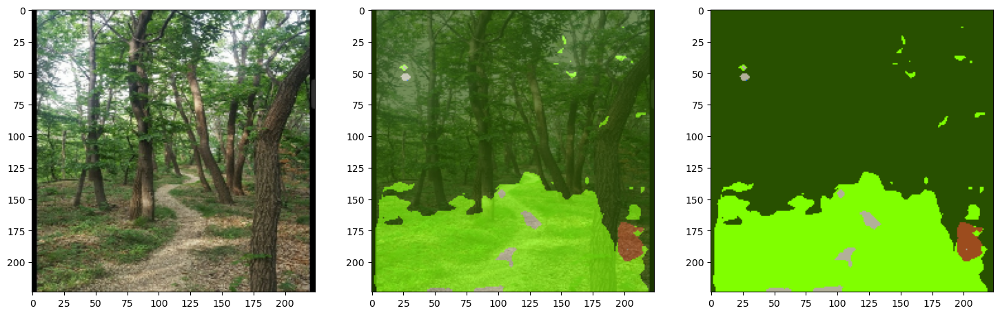

(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2


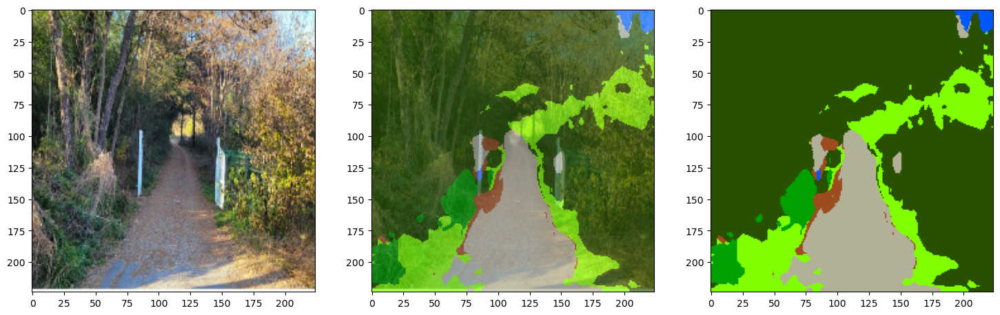

(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2


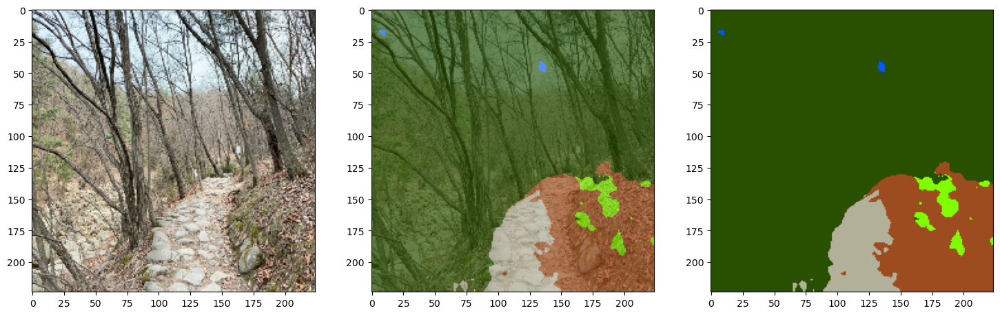

(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2


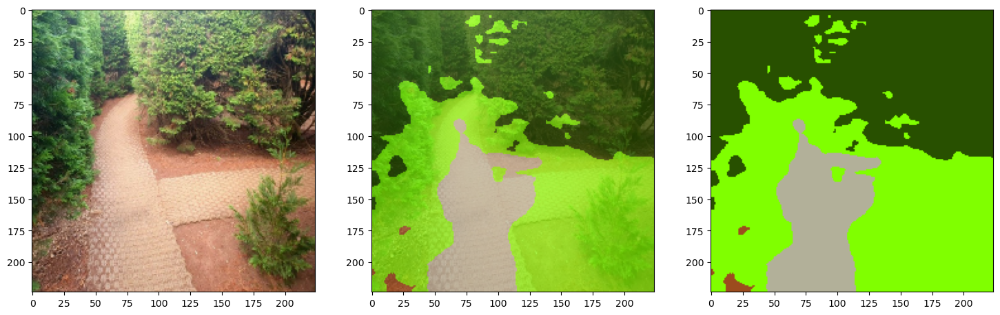

(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2


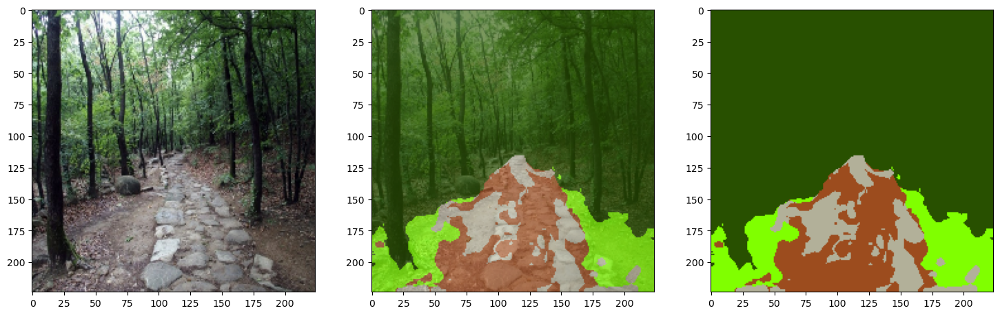

(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2


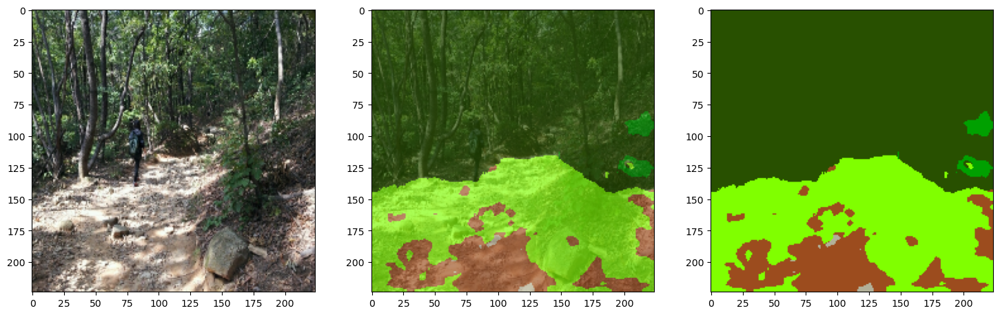

(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2


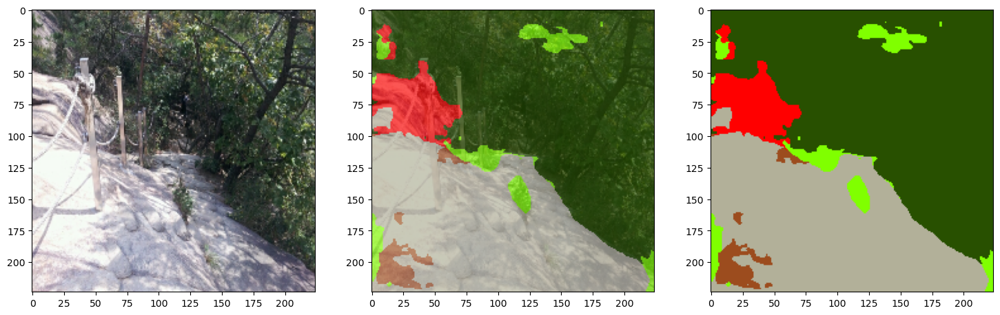

(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2


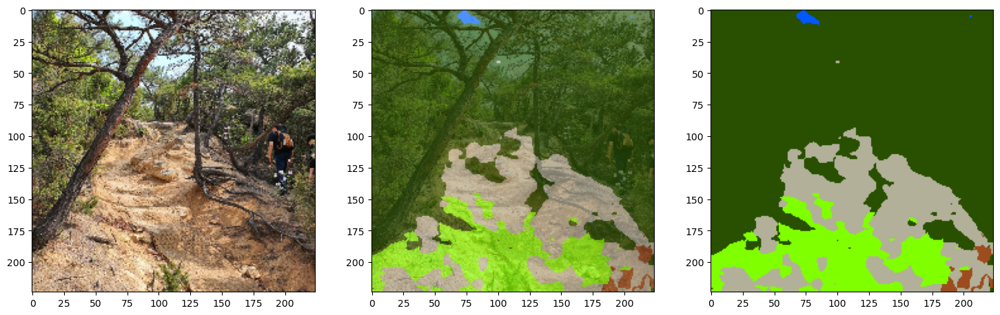

(224, 224, 3) : 0
(224, 224, 3) : 1
(224, 224, 3) : 2


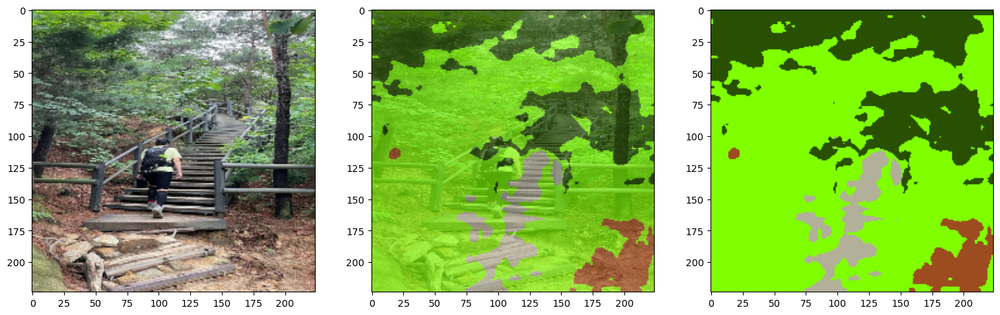

In [37]:
quant_plot_predictions(image_path, out, palette)

In [38]:
import pathlib

tflite_models_dir = pathlib.Path("./tflite_models/")
tflite_models_dir.mkdir(exist_ok = True, parents=True)

tflite_model_file = tflite_models_dir/"mobilenetV2_deeplabV3.tflite"
tflite_model_file.write_bytes(post_quant_tflite_model)

2171184

In [39]:
quantized_size = os.path.getsize(tflite_model_file) / float(2 ** 20)
print(f"{quantized_size:.03f} MB")

2.071 MB
